In [8]:
# === Standard Library ===
import os
import json
import random
from pathlib import Path

# === Third-party Libraries ===
import numpy as np
import cv2
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import seaborn as sns
from tqdm import tqdm
import albumentations as A
from glob import glob

# === Seaborn Style Configuration ===
sns.set_style("white")
sns.set_palette("gray")  # Grayscale for some journals

# === Dataset Label Mapping ===
DATASET_LABELS = {
    'haldensued08': 'F14',
    'haldennord09': 'F21',
    'haldennord10': 'F3',
    'haldensued10': 'F68',
    'lightly': 'FX'
}

# === Paths and Dataset Selection ===
darwin_path = (
    "/mnt/Data-Work-RE/26_Agricultural_Engineering-RE/263_DP/01_Projekte/"
    "2020-Fenaco-Drohnen/code/Rumex-Paper-1/assets/digital-production"
)

datasets = [
    'haldennord09',
    'haldensued10',
    'haldensued08',
    'haldennord10',
    'lightly'
]


In [9]:
def get_latest_darwin_version_on_local(path):
    """
    Returns the highest numeric folder name from a given path.
    
    Example:
        dataset = 'haldensued10'
        dir = os.path.join(darwin_path, dataset, 'releases')
        latest_version = get_latest_darwin_version_on_local(dir)
    """
    try:
        folders = os.listdir(path)
        numbers = [int(folder) for folder in folders if folder.isdigit()]
        return str(max(numbers)) if numbers else None
    except FileNotFoundError:
        print(f"Directory not found: {path}")
        return None
    except Exception as e:
        print(f"Error reading from {path}: {e}")
        return None

dataset = 'haldensued10'
dir = os.path.join(darwin_path, dataset, 'releases')
latest_version = get_latest_darwin_version_on_local(dir)
latest_version

'1'

In [10]:
def get_bounding_box_sizes(darwin_path, dataset):
    """
    Scans annotation JSON files in the latest release of the specified Darwin dataset
    and returns a list of (width, height, area) tuples for all bounding boxes.

    Parameters:
        darwin_path (str): Base path to the Darwin datasets.
        dataset (str): Name of the dataset folder.

    Returns:
        List[Tuple[float, float, float]]: A list of (width, height, area) tuples.
    """
    folder_path = os.path.join(darwin_path, dataset, 'releases')
    v = get_latest_darwin_version_on_local(folder_path)
    ann_folder = os.path.join(folder_path, v, 'annotations')
    
    bbox_sizes = []

    for filename in tqdm(os.listdir(ann_folder), desc=f"Processing {dataset}"):
        if filename.endswith('.json'):
            file_path = os.path.join(ann_folder, filename)
            with open(file_path, 'r', encoding='utf-8') as f:
                data = json.load(f)

            annotations = data.get("annotations", [])
            for ann in annotations:
                bbox = ann.get("bounding_box", {})
                width = bbox.get("w")
                height = bbox.get("h")
                if width is not None and height is not None:
                    area = width * height
                    bbox_sizes.append((width, height, area))
    
    return bbox_sizes

In [4]:
dataset = 'haldensued10'

bbox_tuples = get_bounding_box_sizes(darwin_path, dataset)
print(f"Found {len(bbox_tuples)} bounding boxes.")
print(bbox_tuples[:5])  # show a sample


Processing haldensued10: 100%|██████████| 1842/1842 [00:51<00:00, 35.76it/s]

Found 2829 bounding boxes.
[(57.0, 88.0, 5016.0), (87.0, 56.0, 4872.0), (80.0, 93.0, 7440.0), (104.0, 55.0, 5720.0), (123.0, 75.0, 9225.0)]


# Plotting the distribution of bounding boxes sizes and overlays per dataset

In [5]:
def analyze_datasets(darwin_path, datasets, output_dir='./outputs'):
    n_dataset = 5
    os.makedirs(output_dir, exist_ok=True)
    all_bbox_data = {}

    # Step 1: Collect bounding box data for each dataset
    for dataset in datasets:
        print(f"Processing {dataset}...")
        bboxes = get_bounding_box_sizes(darwin_path, dataset)
        all_bbox_data[dataset] = bboxes

    # Step 2: Boxplot of bounding box areas
    fig1, ax1 = plt.subplots(figsize=(12, 6))
    areas_per_dataset = []
    labels = []
    counts = []

    for dataset in datasets:
        bboxes = all_bbox_data[dataset]
        areas = [w * h for (w, h, _) in bboxes]
        label = DATASET_LABELS.get(dataset, dataset)
        areas_per_dataset.append(areas)
        labels.append(label)
        counts.append(len(areas))

    box = ax1.boxplot(areas_per_dataset, labels=labels, patch_artist=True)
    ax1.set_title("Bounding Box Area Distributions", fontsize=14)
    ax1.set_ylabel("Area (pixels²)", fontsize=12)
    ax1.set_xlabel("Dataset", fontsize=12)
    ax1.grid(True, linestyle="--", alpha=0.6)

    # Adjust text position (lift it up by 5% of the max)
    for i, (areas, count) in enumerate(zip(areas_per_dataset, counts)):
        if areas:
            y = max(areas) * 1.05
            ax1.text(i + 1, y, str(count), ha='center', va='bottom', fontweight='bold')

    plt.tight_layout()
    boxplot_path = os.path.join(output_dir, 'bbox_area_boxplot.png')
    plt.savefig(boxplot_path, dpi=300)
    plt.close()
    print(f"Boxplot saved to {boxplot_path}")

    # Step 3: Bounding box overlays (on empty canvas)
    num_subplots = min(n_dataset, len(datasets))
    fig_width = 20
    fig2, axs = plt.subplots(1, num_subplots, figsize=(fig_width, 4), gridspec_kw={'wspace': 0.2})
    
    if num_subplots == 1:
        axs = [axs]
    
    # Plot bounding boxes for each dataset
    for ax, dataset in tqdm(zip(axs, datasets[:n_dataset]), total=num_subplots, desc="Plotting overlays"):
        label = DATASET_LABELS.get(dataset, dataset)
        ax.set_title(label)
        ax.set_xlim(0, 1024)
        ax.set_ylim(678, 0)
        ax.set_aspect('equal')
        ax.axis('off')
    
        for w, h, _ in all_bbox_data[dataset]:
            x, y = 512 - w / 2, 339 - h / 2
            rect = patches.Rectangle((x, y), w, h, linewidth=1,
                                     edgecolor='black', facecolor='none', alpha=0.05)
            ax.add_patch(rect)
    
    # Add a vertical size scale indicator on the right
    ref_ax = fig2.add_axes([0.92, 0.15, 0.01, 0.7])  # [left, bottom, width, height] in figure coordinates
    ref_ax.set_xlim(0, 1)
    ref_ax.set_ylim(678, 0)
    ref_ax.axis('off')
    
    # Choose a reference height (e.g., 100 pixels)
    ref_height = 250
    ref_y = 339 - ref_height / 2
    
    # Draw the red reference line
    ref_ax.plot([0.5, 0.5], [ref_y, ref_y + ref_height], color='red', linewidth=3)
    ref_ax.text(0.6, ref_y + ref_height / 2, f'{ref_height}px',
                rotation=90, va='center', ha='left', fontsize=14, color='red')
    
    plt.suptitle("Overlay of Bounding Boxes", fontsize=20)
    plt.tight_layout(rect=[0, 0, 0.9, 1])  # leave room for the reference scale
    overlay_path = os.path.join(output_dir, 'bbox_overlay.png')
    plt.savefig(overlay_path, dpi=300)
    plt.close()
    print(f"Overlay figure saved to {overlay_path}")


In [6]:
analyze_datasets(darwin_path, datasets, output_dir='./figures')

Processing haldennord09...


Processing haldennord09: 100%|██████████| 3859/3859 [01:45<00:00, 36.65it/s]


Processing haldensued10...


Processing haldensued10: 100%|██████████| 1842/1842 [00:48<00:00, 38.16it/s]


Processing haldensued08...


Processing haldensued08: 100%|██████████| 1662/1662 [00:43<00:00, 37.98it/s]


Processing haldennord10...


Processing haldennord10: 100%|██████████| 161/161 [00:03<00:00, 41.78it/s]


Processing lightly...


Processing lightly: 100%|██████████| 786/786 [00:22<00:00, 34.89it/s]


Boxplot saved to ./figures/bbox_area_boxplot.png


Plotting overlays: 100%|██████████| 5/5 [00:07<00:00,  1.54s/it]
/tmp/ipykernel_5201/2904702067.py:83: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # leave room for the reference scale


Overlay figure saved to ./figures/bbox_overlay.png


# Plotting a sample image from each dataset

In [11]:
import os
import json
import random
import cv2
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import albumentations as A
from tqdm import tqdm

def get_latest_darwin_version_on_local(releases_path):
    versions = [d for d in os.listdir(releases_path) if os.path.isdir(os.path.join(releases_path, d))]
    if not versions:
        return None
    return sorted(versions)[-1]

def plot_sample_crops_from_datasets(darwin_path, datasets, crop_height=678, crop_width=678, output_dir='./figures'):
    os.makedirs(output_dir, exist_ok=True)

    transform = A.Compose([
        A.AtLeastOneBBoxRandomCrop(height=crop_height, width=crop_width, p=1.0)
    ], bbox_params=A.BboxParams(format='pascal_voc', label_fields=['class_labels']))

    for i in tqdm(range(10)):
        datasets_subset = datasets[:4]
        fig, axes = plt.subplots(1, len(datasets_subset), figsize=(20, 5))
        if len(datasets_subset) == 1:
            axes = [axes]

        plot_idx = 0

        for d in datasets_subset:
            images_path = os.path.join(darwin_path, d, 'images')
            dir = os.path.join(darwin_path, d, 'releases')
            latest_version = get_latest_darwin_version_on_local(dir)
            if latest_version is None:
                continue

            annotations_path = os.path.join(dir, latest_version, 'annotations')
            json_files = [f for f in os.listdir(annotations_path) if f.endswith('.json')]
            if not json_files:
                continue

            random_json = random.choice(json_files)
            with open(os.path.join(annotations_path, random_json), 'r') as f:
                data = json.load(f)

            image_name = data['item']['name']
            image_path = os.path.join(images_path, image_name)
            image = cv2.imread(image_path)
            if image is None:
                continue
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

            # Parse annotations
            bboxes = []
            class_labels = []
            for annotation in data.get('annotations', []):
                if 'bounding_box' not in annotation:
                    continue
                bbox = annotation['bounding_box']
                x_min = bbox['x']
                y_min = bbox['y']
                x_max = x_min + bbox['w']
                y_max = y_min + bbox['h']
                bboxes.append([x_min, y_min, x_max, y_max])
                class_labels.append(annotation.get('name', 'object'))

            if not bboxes:
                continue

            try:
                transformed = transform(image=image, bboxes=bboxes, class_labels=class_labels)
            except Exception as e:
                print(f"Transform failed for {image_name}: {e}")
                continue

            cropped_image = transformed['image']
            cropped_bboxes = transformed['bboxes']

            ax = axes[plot_idx]
            ax.imshow(cropped_image)
            label = DATASET_LABELS.get(d, d)
            ax.set_title(f'{label}', fontsize=12)
            ax.axis('off')

            for bbox in cropped_bboxes:
                x_min, y_min, x_max, y_max = bbox
                rect = patches.Rectangle(
                    (x_min, y_min), x_max - x_min, y_max - y_min,
                    linewidth=2, edgecolor='red', facecolor='none'
                )
                ax.add_patch(rect)

            plot_idx += 1

        # Hide unused subplots
        for j in range(plot_idx, len(axes)):
            axes[j].axis('off')

        plt.tight_layout(rect=[0, 0.03, 1, 0.95])

        fig_path = os.path.join(output_dir, f'sample_images_{i}.png')
        plt.savefig(fig_path, dpi=300)
        plt.show()

        print(f"Sample image visualization saved to {fig_path}")


Sample image visualization saved to ./figures/sample_images_0.png


Sample image visualization saved to ./figures/sample_images_1.png
Transform failed for DJI_20221010143150_0258_4_0.png: Expected x_max for bbox [0.4892578 0.6814159 1.0068359 1.0457227 0.       ] to be in the range [0.0, 1.0], got 1.0068359375.


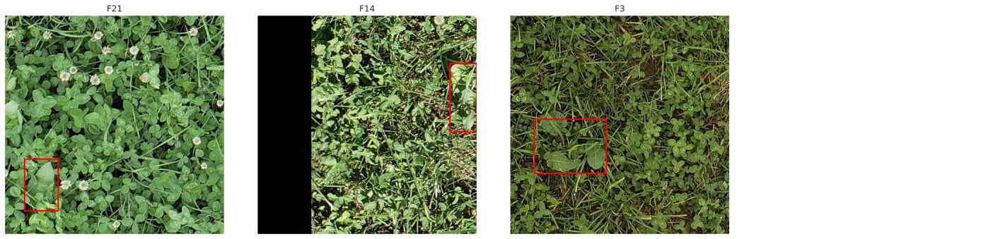

Sample image visualization saved to ./figures/sample_images_2.png


Sample image visualization saved to ./figures/sample_images_3.png
Transform failed for DJI_20221010143420_0407_6_5.png: Expected x_max for bbox [0.9082031  0.79941005 1.0068359  1.0073746  0.        ] to be in the range [0.0, 1.0], got 1.0068359375.


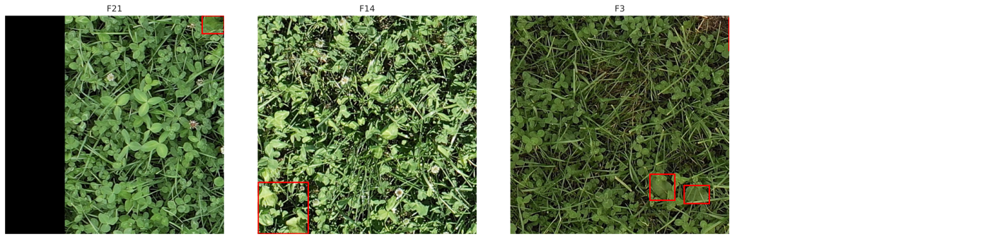

Sample image visualization saved to ./figures/sample_images_4.png
Transform failed for DJI_20221010143702_0567_7_5.png: Expected x_max for bbox [0.95996094 0.12094396 1.0283203  0.32890856 0.        ] to be in the range [0.0, 1.0], got 1.0283203125.


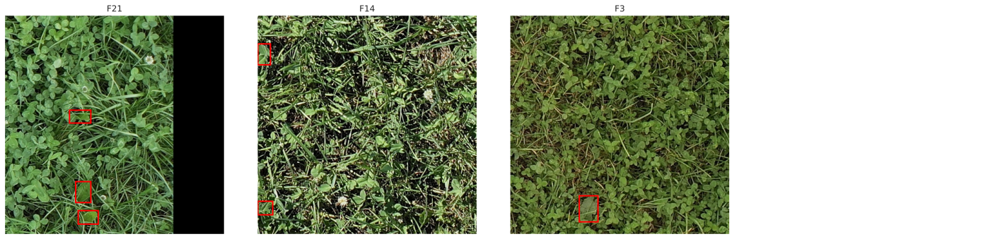

Sample image visualization saved to ./figures/sample_images_5.png


Sample image visualization saved to ./figures/sample_images_6.png
Transform failed for DJI_20221010143631_0536_3_1.png: Expected y_max for bbox [0.3623047  0.7654867  0.54003906 1.020649   0.        ] to be in the range [0.0, 1.0], got 1.0206489562988281.


Sample image visualization saved to ./figures/sample_images_7.png


Sample image visualization saved to ./figures/sample_images_8.png


Sample image visualization saved to ./figures/sample_images_9.png


In [12]:
plot_sample_crops_from_datasets(darwin_path, datasets, crop_height=678, crop_width=678, output_dir='./figures')

# Plotting Sample pictures from the FX dataset

In [6]:
def plot_sample_crops_from_datasets(df, im_dir, ann_dir, crop_height=1000, crop_width=1000, output_path='./figures/sample_crops.png'):
    transform = A.Compose([
        A.AtLeastOneBBoxRandomCrop(height=crop_height, width=crop_width, p=1.0)
    ], bbox_params=A.BboxParams(format='pascal_voc', label_fields=['class_labels']))

    num_datasets = len(df)
    cols = 6
    rows = int((num_datasets + cols - 1) // cols)
    fig, axs = plt.subplots(rows, cols, figsize=(5 * cols, 5 * rows))
    axs = axs.flatten()

    i = 0
    for idx, row in tqdm(df.iterrows(), total=num_datasets, desc="Processing datasets"):
        dataset = row['dataset']
        field_label = row['field_label']
        
        # Find image paths
        img_paths = glob(os.path.join(im_dir, f"{dataset}*.jpg")) + glob(os.path.join(im_dir, f"{dataset}*.png"))
        if not img_paths:
            print(f"No images found for dataset: {dataset}")
            continue
        img_path = random.choice(img_paths)

        # Load image
        image = cv2.imread(img_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        # Load annotation
        basename = os.path.splitext(os.path.basename(img_path))[0]
        ann_path = os.path.join(ann_dir, f"{basename}.json")
        if not os.path.exists(ann_path):
            print(f"Annotation not found for image: {img_path}")
            continue

        with open(ann_path, 'r') as f:
            ann = json.load(f)

        # Parse bounding boxes
        bboxes = []
        labels = []

        for annotation in ann.get('annotations', []):
            if 'bounding_box' not in annotation:
                continue
            bbox = annotation['bounding_box']
            x_min = bbox['x']
            y_min = bbox['y']
            x_max = x_min + bbox['w']
            y_max = y_min + bbox['h']
            bboxes.append([x_min, y_min, x_max, y_max])
            labels.append(annotation.get('name', 'object'))

        if not bboxes:
            continue

        try:
            transformed = transform(image=image, bboxes=bboxes, class_labels=labels)
        except Exception as e:
            print(f"Transform failed for {img_path}: {e}")
            continue

        cropped_img = transformed['image']
        cropped_bboxes = transformed['bboxes']
        cropped_labels = transformed['class_labels']

        ax = axs[i]
        i = i + 1
        ax.imshow(cropped_img)
        ax.set_title(f"{field_label}", fontsize=14)
        ax.axis('off')

        # Draw bboxes
        for bbox, label in zip(cropped_bboxes, cropped_labels):
            x_min, y_min, x_max, y_max = bbox
            rect = patches.Rectangle((x_min, y_min), x_max - x_min, y_max - y_min,
                                     linewidth=1, edgecolor='red', facecolor='none')
            ax.add_patch(rect)
            #ax.text(x_min, y_min - 5, label, fontsize=6, color='white', bbox=dict(facecolor='red', alpha=0.5))

    # Hide unused subplots
    for j in range(i, len(axs)):
        axs[j].axis('off')

    plt.tight_layout()
    plt.savefig(output_path, dpi=300)
    plt.close()
    print(f"Sample crops saved to {output_path}")


In [7]:
import pandas as pd
df = pd.read_csv('../assets/lightly_totalimages_selectedimages_annotated_with_fields_label.csv')
im_dir = os.path.join(darwin_path, 'lightly/images')
ann_dir = os.path.join(darwin_path, 'lightly/releases/1/annotations')
plot_sample_crops_from_datasets(df, im_dir, ann_dir, crop_height=678, crop_width=678)

Processing datasets:   3%|▎         | 2/67 [00:02<01:21,  1.26s/it]

No images found for dataset: 20230421_SchildHohenegg_S_20_F_50_O_sama_ID1


Processing datasets:   6%|▌         | 4/67 [00:12<03:08,  2.98s/it]

No images found for dataset: 20230414_Waldegg_S_70_F_80_O_stra_ID1


Processing datasets:  15%|█▍        | 10/67 [00:20<01:00,  1.06s/it]

No images found for dataset: 20230615_SchildOberhofenBuel2_S_20_F_60_H_12_O_krma_ID2


Processing datasets:  18%|█▊        | 12/67 [00:21<00:41,  1.31it/s]

No images found for dataset: 20230405_Waldegg_S_70_F_80_O_sama_ID1


Processing datasets:  39%|███▉      | 26/67 [00:33<00:27,  1.50it/s]

No images found for dataset: 20230426_SchneiderWallenwil_S_20_F_50_O_krma_ID2


Processing datasets:  54%|█████▎    | 36/67 [00:41<00:20,  1.54it/s]

No images found for dataset: 20230414_Waldegg_S_20_F_50_O_stra_ID1


Processing datasets:  55%|█████▌    | 37/67 [00:41<00:15,  1.91it/s]

No images found for dataset: 20230405_Waldegg_S_20_F_50_O_sama_ID1


Processing datasets:  57%|█████▋    | 38/67 [00:42<00:13,  2.20it/s]

No images found for dataset: 20220816_TaenikonWiese_S_xx_F_xx_O_sama_ID1


Processing datasets:  60%|█████▉    | 40/67 [00:43<00:12,  2.12it/s]

No images found for dataset: 20230504_HoratRitaUnterviertrlNord_S_20_F_50_O_sama_ID1


Processing datasets:  75%|███████▍  | 50/67 [00:50<00:10,  1.62it/s]

No images found for dataset: 20230414_Waldegg_S_10_F_10_O_stra_ID1


Processing datasets:  78%|███████▊  | 52/67 [00:52<00:08,  1.79it/s]

No images found for dataset: 20230606_TestfieldHerrenpuentNordost_S_20_F_60_H_12_O_sama_ID1


Processing datasets:  79%|███████▉  | 53/67 [00:52<00:06,  2.09it/s]

No images found for dataset: 20230405_Waldegg_S_10_F_10_O_sama_ID1


Processing datasets:  85%|████████▌ | 57/67 [00:55<00:05,  1.76it/s]

No images found for dataset: 20220816_TaenikonWiese_S_xx_F_xx_O_sama_ID3


Processing datasets:  87%|████████▋ | 58/67 [00:55<00:04,  2.14it/s]

No images found for dataset: 20230606_TestfieldHerrenpuentNord_S_00_F_00_H_12_O_sama_ID1


Processing datasets:  93%|█████████▎| 62/67 [00:58<00:02,  1.73it/s]

No images found for dataset: 20230616_TestHerrenpuentSuedwestStreifen1_S_00_F_00_H_12_O_sama_ID1


Processing datasets:  99%|█████████▊| 66/67 [01:00<00:00,  1.73it/s]

No images found for dataset: 20230616_TestHerrenpuentSuedwestStreifen3_S_00_F_00_H_12_O_sama_ID3


Processing datasets: 100%|██████████| 67/67 [01:00<00:00,  1.10it/s]

No images found for dataset: 20230426_SchneiderWallenwilTest_S_20_F_50_O_sama_ID2


Sample crops saved to ./figures/sample_crops.png
